# Source

Simulation
- [towardsai](https://pub.towardsai.net/monte-carlo-simulation-an-in-depth-tutorial-with-python-bcf6eb7856c8)
- [towardsdatascience](https://towardsdatascience.com/how-to-create-a-monte-carlo-simulation-using-python-c24634a0978a)
- [pbpython](https://pbpython.com/monte-carlo.html)
- [sonofacorner](https://www.sonofacorner.com/an-introduction-to-monte-carlo/)
- [datasciencedojo](https://medium.com/@juee_thete/understanding-monte-carlo-simulation-and-its-implementation-with-python-3ecacb958cd4)
- [datasciencedojo](https://datasciencedojo.com/blog/monte-carlo-simulation-python/)
- [pythonprogramming](https://pythonprogramming.net/monte-carlo-simulator-python/)
- [altcoinoracle](https://altcoinoracle.com/a-monte-carlo-simulation-in-python/)
- [datacamp](https://www.datacamp.com/courses/monte-carlo-simulations-in-python)


Visuals
- [interactive-plot-libraries](https://mode.com/blog/python-interactive-plot-libraries/)

# Imports

In [1]:
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [ ]:
from ipywidgets import interact, IntSlider, fixed

# Monte-Carlo

## Coin Flip Example

The probability of head for a fair coin is 1/2. However, is there any way we can prove it experimentally?

In [2]:
def coin_flip():
    """_summary_

    Returns:
        _type_: _description_
    """
    return random.randint(0, 1)

In [3]:
def monte_carlo(n:int, debug:bool=False):
    """_summary_

    Args:
        n (int): _description_
        debug (bool, optional): _description_. Defaults to False.

    Returns:
        _type_: _description_
    """
    coin: list[float] = []
    results: int = 0
    
    for i in range(n):
        flip_result: int = coin_flip()
        
        if debug:
            print(flip_result)
        
        results += flip_result
        prob_value: float = results / (i+1)
        coin.append(prob_value)

    plt.plot(coin, linewidth=1, color='r')
    plt.axhline(y=.5, color='g', linestyle='--')
    plt.xlabel('Iterations')
    plt.ylabel("Probability")
    plt.ylim(0,1)
    plt.title(f"Simulation for {n} rounds")
    sns.despine()
    plt.show()
    
    if debug:
        print(coin)
        print(results)
        print(n)
    
    return f'Final probability: {results/n:.2%}'


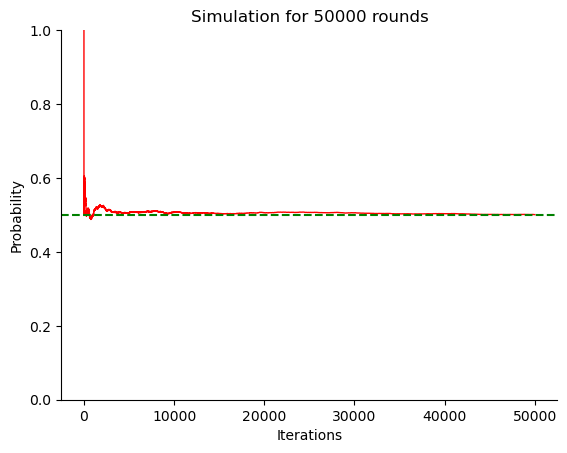

'Final probability: 50.08%'

In [4]:
monte_carlo(50_000, False)

In [5]:
# %matplotlib widget
# monte_carlo(4)

In [7]:
interact(monte_carlo, n= IntSlider(min=1, max=15_000, step=99, value=10_000, continuous_update=False), debug=fixed(False));

interactive(children=(IntSlider(value=10000, continuous_update=False, description='n', max=15000, min=1, step=…

In [9]:
%load_ext blackcellmagic

Animation size has reached 21005833 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


None

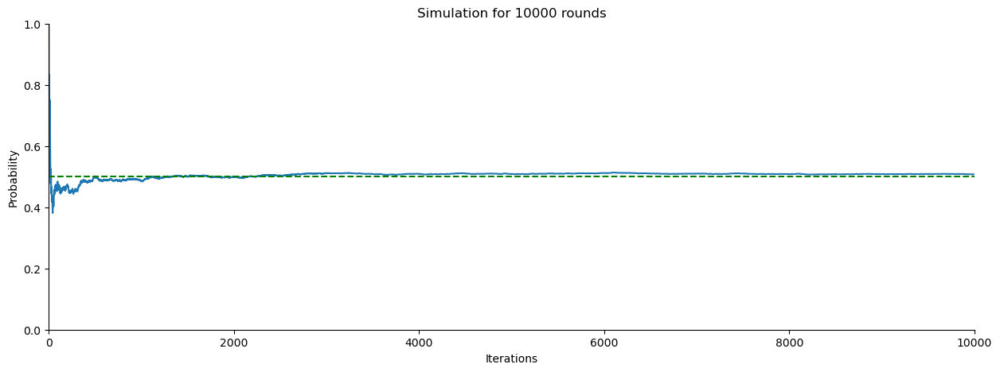

In [40]:
# %matplotlib ipympl

n = 10_000
fig, ax = plt.subplots(figsize=(15, 5))
# plt.rcParams["animation.html"] = "jshtml"

coin: list[float] = []
results: int = 0

for i in range(n):
    flip_result: int = coin_flip()

    results += flip_result
    prob_value: float = results / (i + 1)
    coin.append(prob_value)


def animate(i):
    ax.clear()
    plt.plot(coin[:i])
    plt.axhline(y=0.5, color="g", linestyle="--")
    plt.xlabel("Iterations")
    plt.ylabel("Probability")
    plt.ylim(0, 1)
    plt.xlim(0, n)
    plt.title(f"Simulation for {n} rounds")
    sns.despine()


ani = FuncAnimation(fig, animate, range(1, n, 10), interval=200, blit=False, repeat_delay=500, init_func=None)

# plt.close()
display(display(HTML(ani.to_jshtml())))


In [41]:
display(HTML(ani.to_html5_video()))

In [39]:
# type(ani.to_jshtml())

##  Monty Hall Problem

Suppose you are on a game show, and you have the choice of picking one of three doors: Behind one door is a car; behind the other doors, goats. You pick a door, let’s say door 1, and the host, who knows what’s behind the doors, opens another door, say door 3, which has a goat. The host then asks you: do you want to stick with your choice or choose another door?

    Is it to your advantage to switch your choice of door?